# Uber Project

## Background

This project aims at making recommendations to Uber drivers in order for them to optimize their chances of making a pickup. 
To that effect, we use a dataset containing data on over 500,000 Uber pickups that took place in New York City during the month of April 2014. It consists of four columns including the date and time of the Uber pickup, its latitude, its longitude and the NYC Taxi and Limousine Commission base company code affiliated with the pickup. 

In this example of unsupervised machine learning, we train a K-Means model and a DBSCAN model to cluster our data and make our recommendations. 
They come in the form of a map of NYC in which we locate our different clusters during the month of April 2014. We also provide an interactive map to understand how the different clusters shift at different times of day. We use the Folium library to generate our maps. 

## Table of contents
* Importing libraries and dataset
* Exploratory analysis
* Training a K-Means model
* Mapping our clusters
* Training a DBSCAN model

## Importing libraries and dataset

In [16]:
# Importing libraries
import pandas as pd
import numpy as np
import seaborn as sb
import matplotlib.pyplot as plt
import datetime as dt

from sklearn.cluster import DBSCAN
from sklearn.cluster import KMeans

import folium
from folium.plugins import HeatMap
from folium.plugins import HeatMapWithTime

from sklearn.datasets import make_blobs
from sklearn.metrics import silhouette_samples, silhouette_score
import matplotlib.cm as cm

In [3]:
# Importing dataset
df = pd.read_csv("uber-raw-data-apr14.csv")
df.head()

,Date/Time,Lat,Lon,Base
0,4/1/2014 0:11:00,40.7690,-73.9549,B02512
1,4/1/2014 0:17:00,40.7267,-74.0345,B02512
2,4/1/2014 0:21:00,40.7316,-73.9873,B02512
3,4/1/2014 0:28:00,40.7588,-73.9776,B02512
4,4/1/2014 0:33:00,40.7594,-73.9722,B02512


In [68]:
df.shape

(564516, 9)

## Exploratory analysis

In [4]:
df.dtypes

Date/Time     object
Lat          float64
Lon          float64
Base          object
dtype: object

### Where are we?

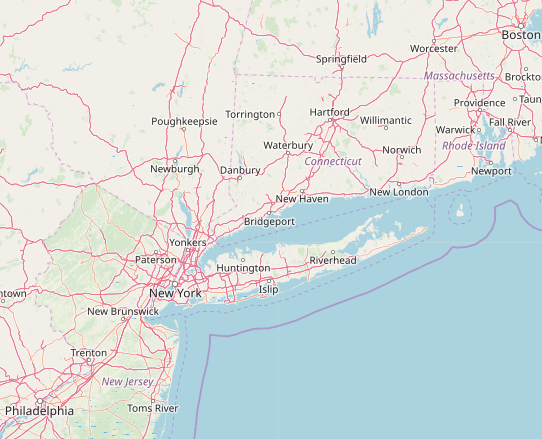

In [5]:
from IPython.display import display, Image
BBox = (df.Lon.min(), df.Lon.max(), df.Lat.min(), df.Lat.max())
ruh_m = plt.imread('map.png')
Image(filename='map.png')
# https://www.openstreetmap.org/export#map=5/51.500/-0.100

Our dataset consists of addresses located in and around New York City. 

### Investigation into the "Date/Time" column 

In [13]:
df['Date/Time'] =  pd.to_datetime(df['Date/Time'], format = "%m/%d/%Y %H:%M:%S")

In [15]:
df['day'] = df['Date/Time'].dt.weekday_name
df['hour'] = df['Date/Time'].dt.hour
df['day_nb'] = df['Date/Time'].dt.dayofweek
df.head()

,Date/Time,Lat,Lon,Base,day,hour
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,Tuesday,0
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,Tuesday,0
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,Tuesday,0
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,Tuesday,0
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,Tuesday,0


When do the pickups take place?

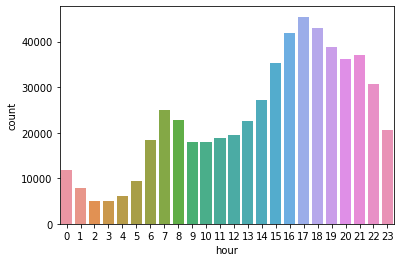

In [57]:
sb.countplot(df.hour)

The pickups mostly take place after 3 pm. Activity peaks in the late afternoon and early evening. 
The least pickups are made in the early morning, between 2 and 4 am. 

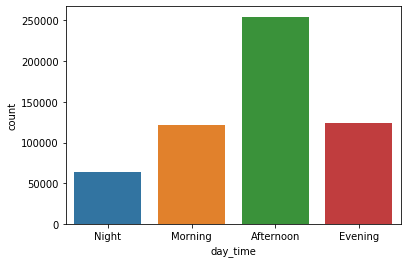

In [58]:
df['day_time'] = df.hour.apply(lambda x: 'Night' if x <= 6
                                         else 'Morning' if x <= 12 
                                         else 'Afternoon' if x <= 19
                                         else 'Evening')
sb.countplot(df['day_time'])

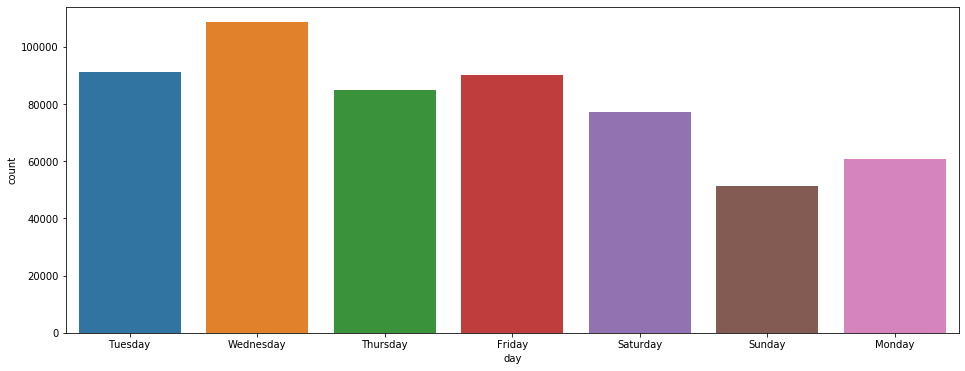

In [56]:
plt.figure(figsize=(16, 6))
sb.countplot(df.day)

Wednesdays are the busiest days. On the contrary, Sundays and Mondays are slower days. 

### Heatmap of the pickups

In [22]:
def generateBaseMap(default_location=[40.693943, -73.985880], default_zoom_start=12):
    base_map = folium.Map(location=default_location, control_scale=True, zoom_start=default_zoom_start)
    return base_map
  
from folium.plugins import HeatMap
df['count'] = 1
base_map = generateBaseMap()
HeatMap(data=df[['Lat', 'Lon', 'count']].groupby(['Lat', 'Lon']).sum().reset_index().values.tolist(), radius=8, gradient={0.2: 'blue', 0.6: 'lime', 0.8: 'orange', 1: 'red'},min_opacity=0.1, max_zoom=13).add_to(base_map)
base_map

Most pickups seem to be located in Manhattan, Brooklyn, Queens and near Hoboken. 

We can also look at the heatmap at different times in the day. 

In [24]:
df_hour_list = []
for hour in df.hour.sort_values().unique():
    df_hour_list.append(df.loc[df.hour == hour, ['Lat', 'Lon','count']].groupby(['Lat', 'Lon']).sum().reset_index().values.tolist())

In [25]:
base_map_time = generateBaseMap(default_zoom_start=11)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map_time)
base_map_time

We can now drop the "Date/Time" and "Base" columns to focus on the latitudes and longitudes. 

In [6]:
df_map = df.drop(columns = ["Date/Time", "Base"])
df_map

,Lat,Lon
0,40.7690,-73.9549
1,40.7267,-74.0345
2,40.7316,-73.9873
3,40.7588,-73.9776
4,40.7594,-73.9722
...,...,...
564511,40.7640,-73.9744
564512,40.7629,-73.9672
564513,40.7443,-73.9889
564514,40.6756,-73.9405


## Training a K-Means model

In [7]:
from sklearn.preprocessing import StandardScaler
sc = StandardScaler()
df_map = sc.fit_transform(df_map)

We first look for the optimal number of clusters using the elbow method. 

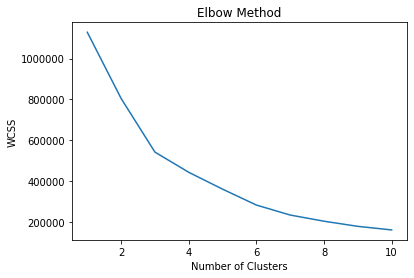

In [8]:
from sklearn.cluster import KMeans
wcss =  []
for i in range (1,11): 
    kmeans = KMeans(n_clusters= i, init = "k-means++", max_iter = 300, n_init = 10, random_state = 0, n_jobs=-1)
    kmeans.fit(df_map)
    wcss.append(kmeans.inertia_)
plt.plot(range(1,11), wcss)
plt.title('Elbow Method')
plt.xlabel('Number of Clusters')
plt.ylabel('WCSS')
plt.show()

We can see an "elbow" at k equals 3, 4 and 5. We investigate those solutions. 

### K = 5

In [9]:
kmeans5 = KMeans(n_clusters= 5, init= "k-means++", max_iter=300, n_init = 10, random_state=0)
y_kmeans5 = kmeans5.fit_predict(df_map)

In [11]:
# Number of observations per cluster
cluster_map = pd.DataFrame()
cluster_map['cluster'] = kmeans5.labels_
cluster_map.cluster.value_counts()

3    290282
1    231299
0     22945
2     15172
4      4818
Name: cluster, dtype: int64

Clusters 3 and 1 are much larger than the rest, especially compared to cluster 4. 

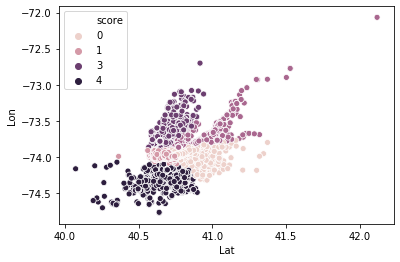

In [48]:
# We can plot the clusters
graph_k5 = pd.DataFrame(kmeans5.labels_ , columns = ['score'])
sb.scatterplot(x = 'Lat' , y = 'Lon' , hue = graph_k5.score , data = df_map)

### K = 4

In [30]:
# Number of observations per cluster
kmeans4 = KMeans(n_clusters = 4, init= "k-means++", max_iter = 300, n_init = 10, random_state = 0)
y_kmeans4 = kmeans4.fit_predict(df_map)
cluster_map = pd.DataFrame()
cluster_map['cluster'] = kmeans4.labels_
cluster_map.cluster.value_counts()

1    284879
0    241835
3     22553
2     15249
Name: cluster, dtype: int64

Similar to the 5-cluster solution, the two largest clusters are disproportionate in size compared to the rest. 

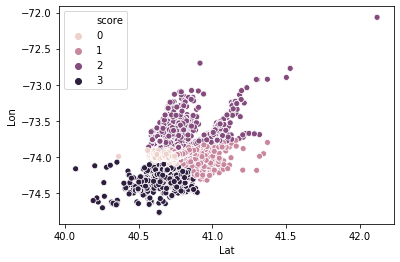

In [51]:
# We can plot the clusters
graph_k4 = pd.DataFrame(kmeans4.labels_ , columns = ['score'])
sb.scatterplot(x = 'Lat' , y = 'Lon' , hue = graph_k4.score , data = df_map)

### K = 3

In [172]:
# Number of observations per cluster
kmeans3 = KMeans(n_clusters = 3, init = "k-means++", max_iter = 300, n_init = 10, random_state = 0)
y_kmeans3 = kmeans3.fit_predict(df_map)
cluster_map = pd.DataFrame()
cluster_map['cluster'] = kmeans3.labels_
cluster_map.cluster.value_counts()

2    288193
0    247153
1     29170
Name: cluster, dtype: int64

Cluster 1 seems unconsequential in size compared to the other two. 

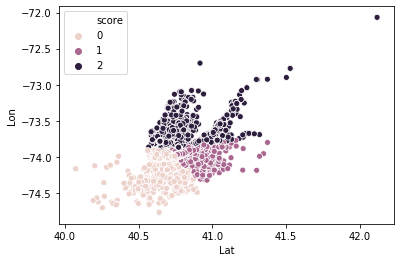

In [53]:
# We can plot the clusters
graph_k3 = pd.DataFrame(kmeans3.labels_ , columns = ['score'])
sb.scatterplot(x = 'Lat' , y = 'Lon' , hue = graph_k3.score , data = df_map)

The 4-cluster option seems to be the most balanced solution when looking at the sizes of the different clusters. 

### Further investigation using the silhouette method.

Automatically created module for IPython interactive environment
For n_clusters = 2 The average silhouette_score is : 0.7049787496083262
For n_clusters = 3 The average silhouette_score is : 0.5882004012129721
For n_clusters = 4 The average silhouette_score is : 0.6505186632729437
For n_clusters = 5 The average silhouette_score is : 0.56376469026194
For n_clusters = 6 The average silhouette_score is : 0.4504666294372765


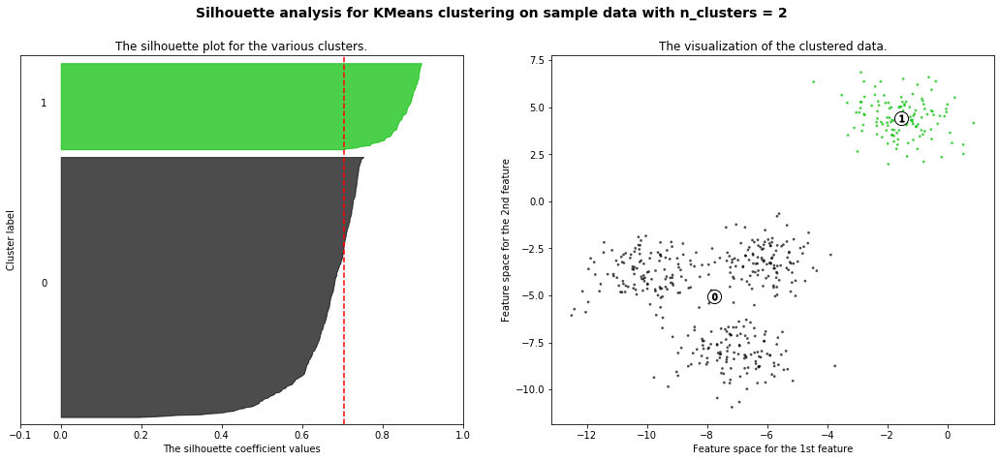

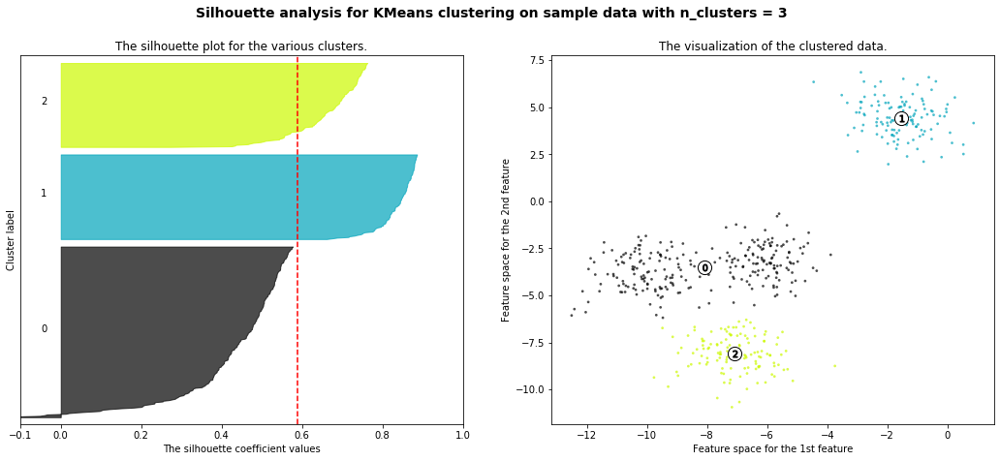

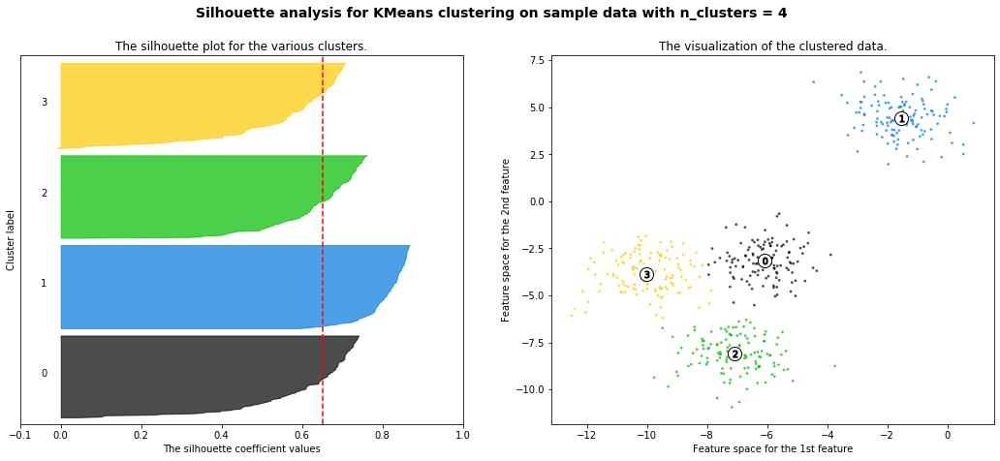

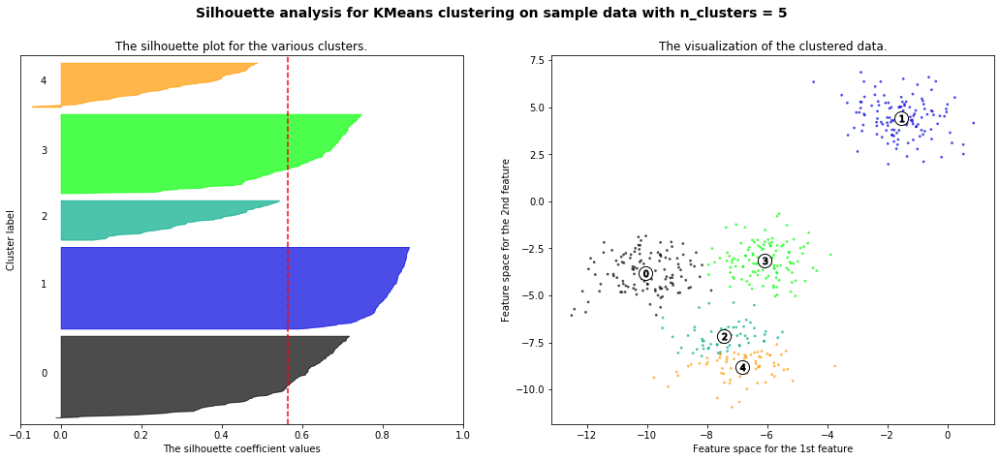

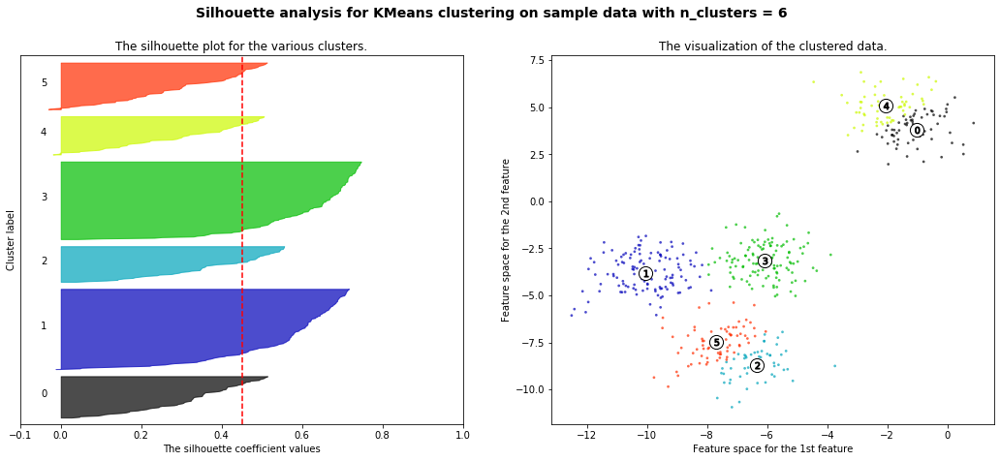

In [26]:
print(__doc__)

# Generating the sample data from make_blobs
# This particular setting has one distinct cluster and 3 clusters placed close
# together.
X, y = make_blobs(n_samples=500,
                  n_features=2,
                  centers=4,
                  cluster_std=1,
                  center_box=(-10.0, 10.0),
                  shuffle=True,
                  random_state=1)  # For reproducibility

range_n_clusters = [2, 3, 4, 5, 6]

for n_clusters in range_n_clusters:
    # Create a subplot with 1 row and 2 columns
    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18, 7)

    # The 1st subplot is the silhouette plot
    # The silhouette coefficient can range from -1, 1 but in this example all
    # lie within [-0.1, 1]
    ax1.set_xlim([-0.1, 1])
    # The (n_clusters+1)*10 is for inserting blank space between silhouette
    # plots of individual clusters, to demarcate them clearly.
    ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

    # Initialize the clusterer with n_clusters value and a random generator
    # seed of 10 for reproducibility.
    clusterer = KMeans(n_clusters=n_clusters, random_state=10)
    cluster_labels = clusterer.fit_predict(X)

    # The silhouette_score gives the average value for all the samples.
    # This gives a perspective into the density and separation of the formed
    # clusters
    silhouette_avg = silhouette_score(X, cluster_labels)
    print("For n_clusters =", n_clusters,
          "The average silhouette_score is :", silhouette_avg)

    # Compute the silhouette scores for each sample
    sample_silhouette_values = silhouette_samples(X, cluster_labels)

    y_lower = 10
    for i in range(n_clusters):
        # Aggregate the silhouette scores for samples belonging to
        # cluster i, and sort them
        ith_cluster_silhouette_values = \
            sample_silhouette_values[cluster_labels == i]

        ith_cluster_silhouette_values.sort()

        size_cluster_i = ith_cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        color = cm.nipy_spectral(float(i) / n_clusters)
        ax1.fill_betweenx(np.arange(y_lower, y_upper),
                          0, ith_cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Label the silhouette plots with their cluster numbers at the middle
        ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

        # Compute the new y_lower for next plot
        y_lower = y_upper + 10  # 10 for the 0 samples

    ax1.set_title("The silhouette plot for the various clusters.")
    ax1.set_xlabel("The silhouette coefficient values")
    ax1.set_ylabel("Cluster label")

    # The vertical line for average silhouette score of all the values
    ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

    ax1.set_yticks([])  # Clear the yaxis labels / ticks
    ax1.set_xticks([-0.1, 0, 0.2, 0.4, 0.6, 0.8, 1])

    # 2nd Plot showing the actual clusters formed
    colors = cm.nipy_spectral(cluster_labels.astype(float) / n_clusters)
    ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                c=colors, edgecolor='k')

    # Labeling the clusters
    centers = clusterer.cluster_centers_
    # Draw white circles at cluster centers
    ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                c="white", alpha=1, s=200, edgecolor='k')

    for i, c in enumerate(centers):
        ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                    s=50, edgecolor='k')

    ax2.set_title("The visualization of the clustered data.")
    ax2.set_xlabel("Feature space for the 1st feature")
    ax2.set_ylabel("Feature space for the 2nd feature")

    plt.suptitle(("Silhouette analysis for KMeans clustering on sample data "
                  "with n_clusters = %d" % n_clusters),
                 fontsize=14, fontweight='bold')

plt.show()

Our different criteria point to the 4-cluster option as the ideal solution. That is how we train our model.  

In [33]:
kmean = kmeans4.fit(df_map)

In [34]:
centroids = kmean.cluster_centers_
centroids_tuples = tuple(map(tuple, centroids))
centroids_list = list(centroids_tuples)
centroids_list

[(-0.6694045710319214, -0.369017271304697),
 (0.5514363851731041, -0.043498479903994726),
 (-2.2716234047378165, 3.8424327396646056),
 (1.77923891201334, 1.9180683900626039)]

## Mapping the clusters

In [37]:
df['count'] = 1
base_map_k = generateBaseMap()
HeatMap(data=df[['Lat', 'Lon', 'count']].groupby(['Lat', 'Lon']).sum().reset_index().values.tolist(), radius=8, min_opacity=0.1,max_zoom=13).add_to(base_map_k)

for coord in centroids_list:
  folium.CircleMarker(location=([ coord[0], coord[1] ]), radius=10,color='darkblue',fill_color='darkblue').add_to(base_map_k)
base_map_k

We can also map the centroids at different times of day. 

In [40]:
df_hour_list = []
for hour in df.hour.sort_values().unique():
    df_hour_list.append(df.loc[df.hour == hour, ['Lat', 'Lon','count']].groupby(['Lat', 'Lon']).sum().reset_index().values.tolist())

from folium.plugins import HeatMapWithTime
base_map_time_k = generateBaseMap(default_zoom_start=11)
HeatMapWithTime(df_hour_list, radius=5, gradient={0.2: 'blue', 0.4: 'lime', 0.6: 'orange', 1: 'red'}, min_opacity=0.5, max_opacity=0.8, use_local_extrema=True).add_to(base_map_time_k)

for coord in centroids_list:
  folium.CircleMarker(location=([ coord[0], coord[1] ]), radius=10,color='darkblue',fill_color='darkblue').add_to(base_map_time_k)

base_map_time_k

## Training a DBSCAN model

We can use a restricted dataset in order to facilitate the training of our model. 
To that effect we focus on the busiest time of the week, that is Wednesdays at 5 pm. 

In [60]:
busiest_time = df.loc[(df['day_nb']== 2) & (df['hour'] == 17)]
busiest_time = busiest_time.iloc[:,1:3]

In [61]:
max_distance = 0.005 #5 metres between each pickup
min_pickups = 5 #5 pickups to create a point

In [62]:
from sklearn.cluster import DBSCAN
dbsc = DBSCAN(eps = max_distance, min_samples = min_pickups).fit(busiest_time)

In [64]:
dbsc_predict = dbsc.fit_predict(busiest_time)
coord_dbsc = dbsc.components_

We can plot the clusters we created. 

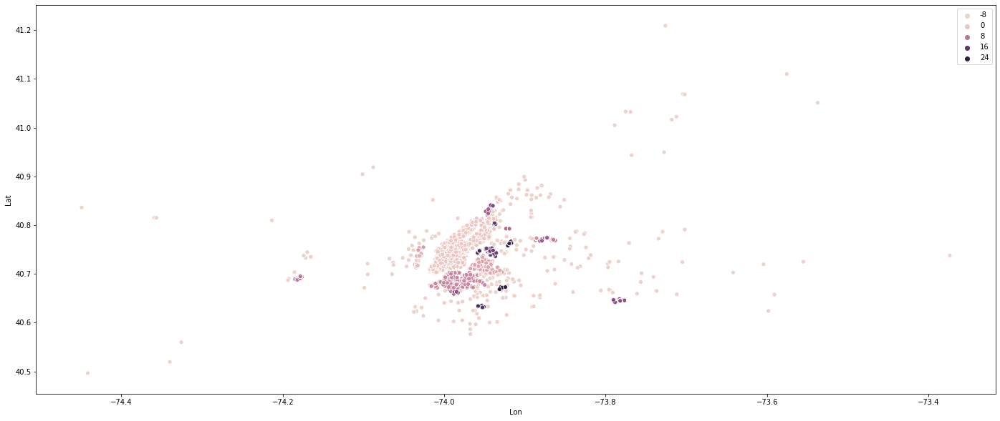

In [67]:
plt.figure(figsize=(24, 10))
sns.scatterplot(busiest_time.iloc[:,1], busiest_time.iloc[:, 0],hue = dbsc_predict)